In [1]:
# Elaborado por Andrés León
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def clean_dataset(df):
  assert isinstance(df, pd.DataFrame), "df needs to be a pd.DataFrame"
  df.dropna(inplace=True)
  indices_to_keep = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
  return df[indices_to_keep].astype(np.float64)

# Se importa el dataset
df = pd.read_csv('house prices/application_train.csv')

In [2]:
df

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [3]:
categoric_columns = [
    'NAME_CONTRACT_TYPE', 
    'NAME_TYPE_SUITE', 
    'NAME_INCOME_TYPE',
    'NAME_EDUCATION_TYPE', 
    'NAME_FAMILY_STATUS', 
    'NAME_HOUSING_TYPE',
    'OCCUPATION_TYPE',
    'WEEKDAY_APPR_PROCESS_START',                         
    'ORGANIZATION_TYPE',          
    'NONLIVINGAREA_MEDI',       
    'HOUSETYPE_MODE',    
    'FONDKAPREMONT_MODE',                                  
    'WALLSMATERIAL_MODE',                                  
    'EMERGENCYSTATE_MODE',
]

In [4]:
for column in categoric_columns:
    print(df[column].value_counts())
    print('-----------------------')

Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, dtype: int64
-----------------------
Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64
-----------------------
Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64
-----------------------
Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary                    3816
Academic degree                     164
Name: NAME_EDUCATION_TYPE, dtype: int64
-----------------------
Married                 196432
Single / not married     45444
Civil ma

In [5]:
# Convierto las variables categoricas en booleanos para poder analizarlas
df = pd.get_dummies(df, columns=categoric_columns)
df

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FONDKAPREMONT_MODE_reg oper spec account,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes
0,100002,1,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,...,0,0,0,0,0,0,1,0,1,0
1,100003,0,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,...,0,1,0,0,0,0,0,0,1,0
2,100004,0,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,M,N,N,0,157500.0,254700.0,27558.0,225000.0,...,0,0,0,0,0,0,1,0,1,0
307507,456252,0,F,N,Y,0,72000.0,269550.0,12001.5,225000.0,...,0,0,0,0,0,0,1,0,1,0
307508,456253,0,F,N,Y,0,153000.0,677664.0,29979.0,585000.0,...,0,0,0,0,0,1,0,0,1,0
307509,456254,1,F,N,Y,0,171000.0,370107.0,20205.0,319500.0,...,0,0,0,0,0,0,1,0,1,0


In [6]:
df['CODE_GENDER'].value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [7]:
df['FLAG_OWN_CAR'].value_counts()

N    202924
Y    104587
Name: FLAG_OWN_CAR, dtype: int64

In [8]:
df['FLAG_OWN_REALTY'].value_counts()

Y    213312
N     94199
Name: FLAG_OWN_REALTY, dtype: int64

In [9]:
# CODE_GENDER, FLAG_OWN_CAR y FLAG_OWN_REALITY solo poseen valores Y y N por lo tanto se convierte en booleano y se deja el valor en una sola columna
df = pd.get_dummies(df, columns=['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY'], drop_first=True)
df

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,CODE_GENDER_M,CODE_GENDER_XNA,FLAG_OWN_CAR_Y,FLAG_OWN_REALTY_Y
0,100002,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,...,0,0,1,0,1,0,1,0,0,1
1,100003,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,...,0,0,0,0,1,0,0,0,0,0
2,100004,0,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,...,0,0,0,0,0,0,1,0,1,1
3,100006,0,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,...,0,0,0,0,0,0,0,0,0,1
4,100007,0,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,...,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,157500.0,254700.0,27558.0,225000.0,0.032561,-9327,-236,...,0,0,1,0,1,0,1,0,0,0
307507,456252,0,0,72000.0,269550.0,12001.5,225000.0,0.025164,-20775,365243,...,0,0,1,0,1,0,0,0,0,1
307508,456253,0,0,153000.0,677664.0,29979.0,585000.0,0.005002,-14966,-7921,...,0,1,0,0,1,0,0,0,0,1
307509,456254,1,0,171000.0,370107.0,20205.0,319500.0,0.005313,-11961,-4786,...,0,0,1,0,1,0,0,0,0,1


In [10]:
# Se limpia el dataset
df = clean_dataset(df)
# df.info(verbose=True)                             

In [11]:
# Utilizamos el describe para obtener un resumen descriptivo del dataset
df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,CODE_GENDER_M,CODE_GENDER_XNA,FLAG_OWN_CAR_Y,FLAG_OWN_REALTY_Y
count,11351.000000,11351.000000,11351.000000,1.135100e+04,1.135100e+04,11351.000000,1.135100e+04,11351.000000,11351.000000,11351.000000,...,11351.000000,11351.000000,11351.000000,11351.000000,11351.000000,11351.000000,11351.000000,11351.000000,11351.0,11351.000000
mean,278892.626641,0.060347,0.579420,2.211785e+05,7.076174e+05,31689.027751,6.406565e+05,0.024095,-14483.533433,17310.202802,...,0.010836,0.481103,0.393710,0.018148,0.991983,0.008017,0.494846,0.000088,1.0,0.685402
std,102994.131531,0.238139,0.768095,1.352612e+05,4.662878e+05,16580.842224,4.309243e+05,0.016970,3547.769641,82583.957313,...,0.103535,0.499665,0.488593,0.133493,0.089182,0.089182,0.499995,0.009386,0.0,0.464376
min,100083.000000,0.000000,0.000000,2.925000e+04,4.500000e+04,2317.500000,4.500000e+04,0.000290,-25018.000000,-15183.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000
25%,189234.000000,0.000000,0.000000,1.350000e+05,3.156660e+05,19867.500000,2.700000e+05,0.010643,-16762.500000,-3010.500000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,0.000000
50%,278894.000000,0.000000,0.000000,1.890000e+05,5.925600e+05,29353.500000,4.950000e+05,0.020246,-14029.000000,-1573.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,1.000000
75%,369246.500000,0.000000,1.000000,2.700000e+05,9.741600e+05,40459.500000,9.000000e+05,0.030755,-11707.000000,-679.500000,...,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.0,1.000000
max,456226.000000,1.000000,5.000000,4.500000e+06,4.050000e+06,225000.000000,4.050000e+06,0.072508,-7708.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000


<ipython-input-13-e286f57ea2b0>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


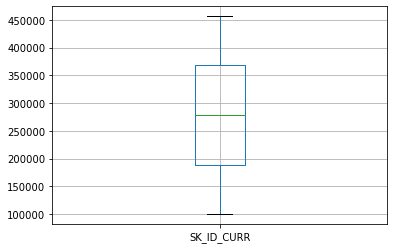

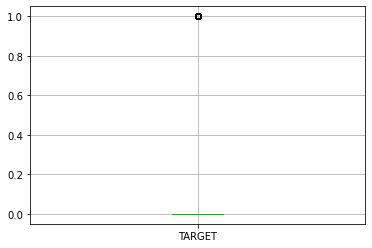

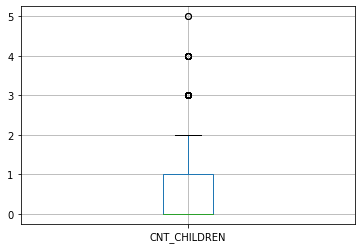

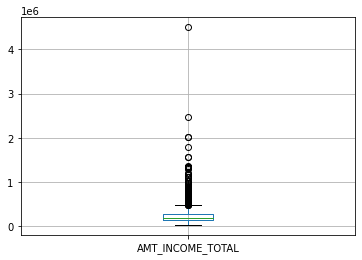

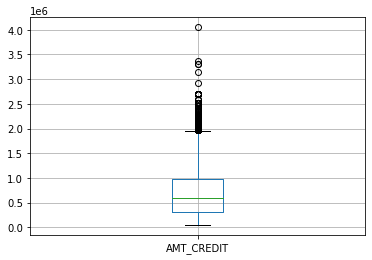

...

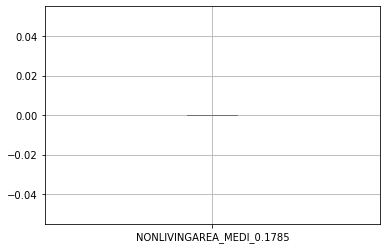

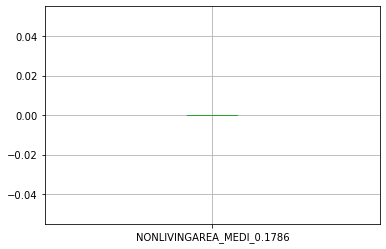

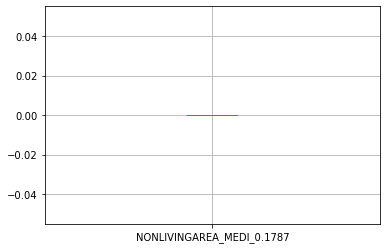

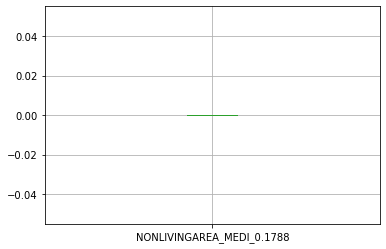

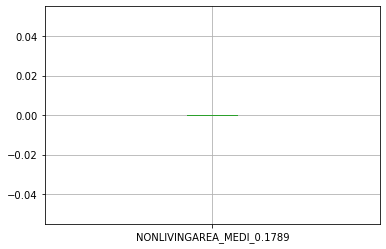

In [13]:
for column in df.columns:
    plt.figure()
    df.boxplot([column])

In [14]:
df.corr()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,EMERGENCYSTATE_MODE_No,EMERGENCYSTATE_MODE_Yes,CODE_GENDER_M,CODE_GENDER_XNA,FLAG_OWN_CAR_Y,FLAG_OWN_REALTY_Y
SK_ID_CURR,1.000000,0.014514,0.004687,-0.006345,-0.007181,-0.024627,-0.009445,-0.000177,0.003676,0.002162,...,0.012547,-0.004197,-0.000039,0.004817,-0.004077,0.004077,-0.007172,0.003736,NaN,-0.007428
TARGET,0.014514,1.000000,-0.016330,-0.045994,-0.022134,-0.006698,-0.030115,-0.030274,0.046180,-0.012599,...,-0.001510,-0.017442,0.021436,0.023748,-0.018703,0.018703,0.033321,-0.002379,NaN,0.005178
CNT_CHILDREN,0.004687,-0.016330,1.000000,-0.007750,-0.013902,-0.013488,-0.018807,-0.027882,0.214119,-0.141821,...,0.006350,-0.006477,-0.001509,0.005705,0.004794,-0.004794,-0.009774,-0.007081,NaN,0.023493
AMT_INCOME_TOTAL,-0.006345,-0.045994,-0.007750,1.000000,0.353354,0.425783,0.359710,0.226279,-0.066175,-0.062005,...,-0.005333,0.032295,-0.061536,-0.009235,0.011544,-0.011544,0.117616,0.001827,NaN,-0.011810
AMT_CREDIT,-0.007181,-0.022134,-0.013902,0.353354,1.000000,0.751773,0.987848,0.127711,-0.164384,0.007740,...,-0.004604,0.014089,-0.025467,-0.023028,0.005510,-0.005510,-0.025526,-0.003374,NaN,-0.044271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EMERGENCYSTATE_MODE_Yes,0.004077,0.018703,-0.004794,-0.011544,-0.005510,0.001276,-0.009187,-0.043487,-0.000666,0.000607,...,0.019217,-0.078654,-0.027959,0.357811,-1.000000,1.000000,-0.015868,-0.000844,NaN,-0.007173
CODE_GENDER_M,-0.007172,0.033321,-0.009774,0.117616,-0.025526,0.013115,-0.026248,-0.010740,0.046830,-0.047814,...,-0.006580,0.022798,-0.012070,-0.006519,0.015868,-0.015868,1.000000,-0.009290,NaN,-0.060298
CODE_GENDER_XNA,0.003736,-0.002379,-0.007081,0.001827,-0.003374,-0.002655,0.005649,0.006470,0.012791,-0.002228,...,-0.000982,-0.009038,0.011648,-0.001276,0.000844,-0.000844,-0.009290,1.000000,NaN,0.006359
FLAG_OWN_CAR_Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
